In [1]:
import numpy as np
import pandas as pd
import plotly.graph_objects as go
import seaborn as sns
import matplotlib.pyplot as plt
from scipy import stats

In [2]:
df = pd.read_csv('marketing_campaign.csv',sep='\t')

In [3]:
s_df = df.sample(n=100, random_state = 100)

In [4]:
s_df

,ID,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,...,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Z_CostContact,Z_Revenue,Response
1514,3865,1977,2n Cycle,Together,20981.0,0,0,30-04-2013,14,2,...,8,0,0,0,0,0,0,3,11,1
864,4120,1975,2n Cycle,Single,49514.0,1,0,17-12-2013,61,88,...,7,0,0,0,0,0,0,3,11,0
1085,6295,1977,Graduation,Married,54233.0,0,1,04-02-2013,46,652,...,8,0,0,0,0,0,0,3,11,0
1575,4967,1960,PhD,Together,38201.0,0,1,29-03-2013,19,233,...,8,0,0,0,0,0,0,3,11,0
1254,5011,1963,Graduation,Divorced,68118.0,0,1,18-10-2013,51,595,...,6,0,0,0,0,0,0,3,11,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
610,7930,1969,Master,Single,26877.0,0,0,19-08-2013,74,101,...,6,0,0,0,0,0,0,3,11,0
2042,8416,1981,Graduation,Married,29009.0,1,0,29-11-2013,19,6,...,6,0,0,0,0,0,0,3,11,0
843,11121,1981,Graduation,Married,19419.0,1,0,10-11-2012,76,2,...,9,0,0,0,0,0,0,3,11,0
1072,3807,1955,Graduation,Together,59925.0,0,1,30-11-2012,83,473,...,6,0,0,0,0,0,0,3,11,0


# example of whether “Education” and “Response” are independent.

Hypothesis Test : Chi-Square test 
-> Chi-Square is used for testing relationship between two categorica varibles.
-> then one categorical variable should have similar composition when the other categorical variable change

# use stacked bar chart and contingency table to summary the count of each category.

In [5]:
ed_contingency = pd.crosstab(s_df['Education'],s_df['Response'])
ed_contingency

Response,0,1
Education,,
2n Cycle,13,3
Basic,2,0
Graduation,44,5
Master,9,4
PhD,17,3


In [6]:
response_0 = list(ed_contingency[0])
response_1 = list(ed_contingency[1])
categories = list(s_df['Education'].unique())

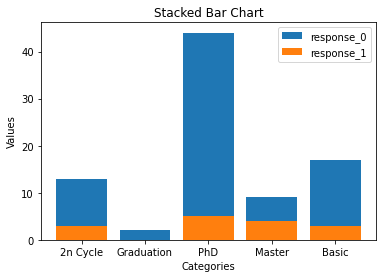

In [7]:
plt.bar(categories,response_0, label='response_0')
plt.bar(categories,response_1, label='response_1')

# Add labels and a legend
plt.xlabel('Categories')
plt.ylabel('Values')
plt.title('Stacked Bar Chart')
plt.legend()

# Show the plot
plt.show()

If these two variables are completely independent to each other (null hypothesis is true), then the proportion of positive Response and negative Response should be the same across all Education groups. It seems like composition are slightly different, but is it significant enough to say there is dependency - let’s run a Chi-Squared test.

1. define hypothesis: 

null hypothesis: “Education” and “Response” are independent to each other.

alternative hypothesis: “Education” and “Response” are dependent to each other.

# Chi-distribution is also determined by the degree of freedom which is (row - 1) x (column - 1).

In [8]:
r = ed_contingency.shape[0]
c = ed_contingency.shape[1]

In [9]:
dof = (r-1)*(c-1)
rv = stats.chi2(df=dof)

In [10]:
chi2_stat, p_value, dof, exp = stats.chi2_contingency(ed_contingency)

In [11]:
x = np.linspace(rv.ppf(0.0001), rv.ppf(0.9999), 100000)
y = rv.pdf(x)


In [12]:
# Calculate the critical value for the significance level
alpha = 0.05
chi2_critical = stats.chi2.ppf(1 - alpha, dof)

In [13]:
fig = go.Figure()

In [14]:
fig.add_trace(go.Scatter(x=x,y=y, mode='lines', name='Chi2_distribution' ))

fig.update_xaxes(title='Chi2_distribution')
fig.update_yaxes(title='Probability Density')

# Significan level
fig.add_shape(
    type='line',
    x0=chi2_critical,
    x1=chi2_critical,
    y0=0,
    y1=max(y),
    line=dict(color='green', width=2),
    name='Significance level'
    )



# Chi2_statistics line
fig.add_shape(
    type = 'line',
    x0=chi2_stat,
    x1=chi2_stat,
    y0=0,
    y1=max(y),
    line=dict(color='brown', width=2),
    name='Test Statistic')

# Highlight the area representing the p-value
if chi2_stat < 0:
    fig.add_trace(go.Scatter(x=x[x <= chi2_stat], y=y[x <= chi2_stat],
                             fill='tozeroy', mode='none',
                             fillcolor='rgba(0, 0, 255, 0.2)',
                             name='p-value Area'))
else:
    fig.add_trace(go.Scatter(x=x[x >= chi2_stat], y=y[x >= chi2_stat],
                             fill='tozeroy', mode='none',
                             fillcolor='rgba(0, 0, 255, 0.2)',
                             name='p-value Area'))
    

fig.add_annotation(
    text=f'chi2_statistic: {chi2_stat:.4f}',
    x=chi2_stat, y=max(y) * 0.8, showarrow=True,
    arrowhead=2, ax=0, ay=-20, arrowwidth=2
)

fig.add_annotation(
    text=f'Significance level: {0.05}',
     x=chi2_critical, y=max(y) * 0.8, showarrow=True,
    arrowhead=2, ax=0, ay=-20, arrowwidth=2
)

fig.show()

# the p-value here is 0.41, suggesting that it is not statistical significant. Therefore, we cannot reject the null hypothesis that these two categorical variables are independent. This further indicates that “Education” may not be a strong predictor of “Response”.